In [3]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import warnings
warnings.filterwarnings('ignore')
import anndata as ad

In [5]:
binary_matrix = pd.read_csv('../MOFA/MOFA_15_Factors_6082HVG/binary_matrix_15_factors.csv', index_col='Unnamed: 0')
adata = sc.read_h5ad('../MOFA/adata_combined_even_more_hvg.h5ad')

In [10]:
genes_mofa_factors = binary_matrix.T.columns.tolist()

In [50]:
len(genes_mofa_factors)

2478

In [11]:
sc.tl.rank_genes_groups(adata, groupby='Condition', layer='log_norm')

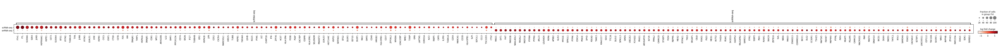

In [38]:
sc.pl.rank_genes_groups_dotplot(adata, groupby='Condition', values_to_plot='logfoldchanges', n_genes=100)

In [20]:
df = pd.DataFrame(adata.uns['rank_genes_groups']['names'])

In [28]:
df_sc = sc.get.rank_genes_groups_df(adata, group='scRNA-seq')
df_sn = sc.get.rank_genes_groups_df(adata, group='snRNA-seq')

In [31]:
de_sc = df_sc[df_sc.logfoldchanges>5].names.tolist()
de_sn = df_sn[df_sn.logfoldchanges>5].names.tolist()

In [40]:
sc_remove = ([i for i in de_sc if i in genes_mofa_factors])
sn_remove = ([i for i in de_sn if i in genes_mofa_factors])

In [47]:
genes_to_remove_techincal_variability= sn_remove + sc_remove

In [48]:
len(genes_to_remove_techincal_variability)

85

In [ ]:
plt.rcParams['figure.figsize'] = (12,10)
sc.pl.umap(adata, color=['Level_0', 'Level_1'], frameon=False)

In [428]:
# sc.pl.umap(adata, color=['outlier'], groups='1', size=10, frameon=False)
#TODO remove?

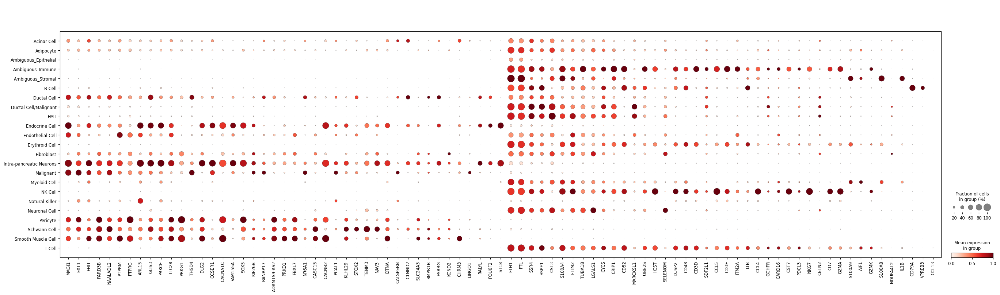

In [57]:
sc.pl.dotplot(adata, groupby='Level_1', var_names=genes_to_remove_techincal_variability,standard_scale='var', layer='log_norm' )

In [58]:
adata_sc = adata[adata.obs['Condition'] == 'scRNA-seq']
adata_sn = adata[adata.obs['Condition'] == 'snRNA-seq']

In [85]:
adata.X = adata.layers['log_norm'].copy()

In [110]:
import scarches as sca

 captum (see https://github.com/pytorch/captum).


In [111]:
adata.obs['ID_batch_covariate'] = adata.obs.ID.astype(str) + '_' + adata.obs.Dataset.astype(str)
adata.obs['ID_batch_covariate'] = adata.obs['ID_batch_covariate'].astype('category')

In [168]:
adata.X = adata.layers['raw'].copy()

In [169]:
adata.X = adata.X.astype('float32')

In [174]:
adata_subset = sc.pp.subsample(adata, fraction=0.1, copy=True)

In [175]:
mask = np.ones((adata_subset.shape[1], 20)) 
adata_subset.varm['mask'] = mask

In [176]:
intr_cvae = sca.models.EXPIMAP(
    adata=adata_subset,
    condition_key='ID_batch_covariate',
    hidden_layer_sizes=[300, 300, 300],
    recon_loss='nb',
    mask_key='mask'
)


INITIALIZING NEW NETWORK..............
Encoder Architecture:
	Input Layer in, out and cond: 6082 300 192
	Hidden Layer 1 in/out: 300 300
	Hidden Layer 2 in/out: 300 300
	Mean/Var Layer in/out: 300 20
Decoder Architecture:
	Masked linear layer in, ext_m, ext, cond, out:  20 0 0 192 6082
	with hard mask.
Last Decoder layer: softmax


In [177]:
ALPHA = 0.7
early_stopping_kwargs = {
    "early_stopping_metric": "val_unweighted_loss", # val_unweighted_loss
    "threshold": 0,
    "patience": 50,
    "reduce_lr": True,
    "lr_patience": 13,
    "lr_factor": 0.1,
}
intr_cvae.train(
    n_epochs=10,
    alpha_epoch_anneal=3,
    alpha=ALPHA,
    alpha_kl=0.5,
    weight_decay=0.,
    early_stopping_kwargs=early_stopping_kwargs,
    use_early_stopping=True,
    monitor_only_val=False,
    seed=2020,
)

Preparing (86821, 6082)
Instantiating dataset
Init the group lasso proximal operator for the main terms.
 |████████████████████| 100.0%  - epoch_loss: 1815.6027018229 - epoch_recon_loss: 1784.5378346163 - epoch_kl_loss: 62.1297257866 - val_loss: 1745.4665688907 - val_recon_loss: 1714.1543543199 - val_kl_loss: 62.62442487833
Saving best state of network...
Best State was in Epoch 9


In [179]:
adata_subset.obsm['X_cvae'] = intr_cvae.get_latent(mean=False, only_active=True)
# adata.uns['terms'] = adata.uns['terms'].tolist()

In [180]:
sc.pp.neighbors(adata_subset, use_rep='X_cvae')
sc.tl.umap(adata_subset)

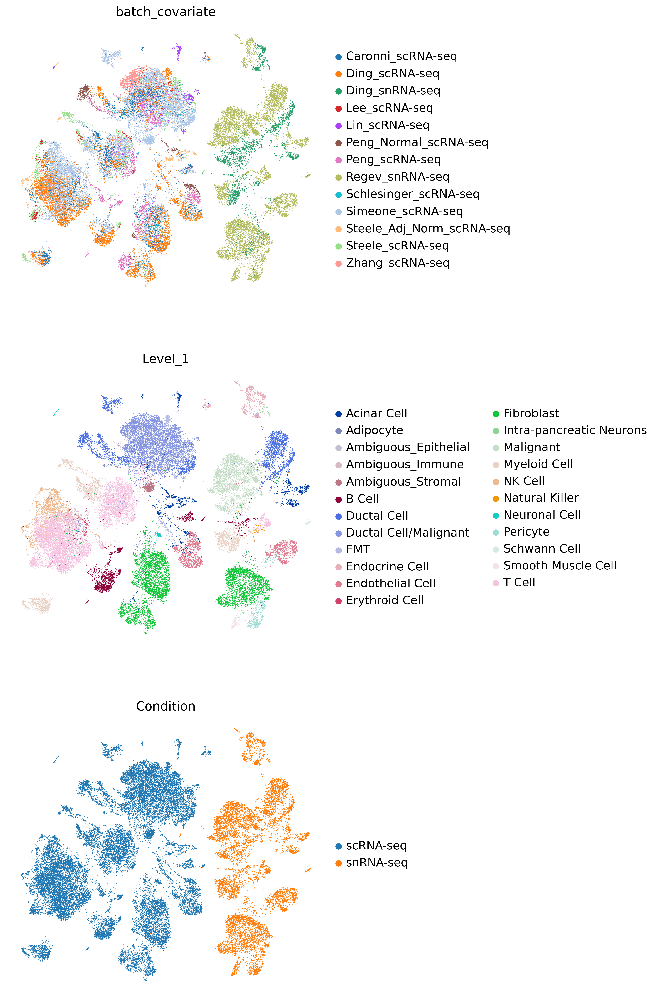

In [181]:
plt.rcParams['figure.figsize'] = (6, 6)
random_indices = np.random.permutation(list(range(adata_subset.shape[0])))
sc.pl.umap(adata_subset[random_indices, :], color=['batch_covariate', 'Level_1', 'Condition'], frameon=False, ncols=1)

In [198]:
adata_subset.uns['terms'] = ['Factor' + str(i) for i in range(0,20)]

In [222]:
intr_cvae.latent_directions(adata=adata_subset)
intr_cvae.latent_enrich(groups='Level_1', use_directions=True, adata=adata_subset)

In [265]:
%matplotlib inline

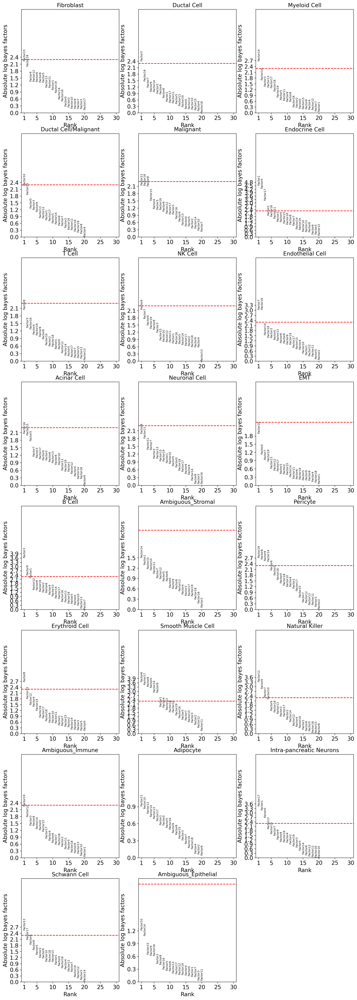

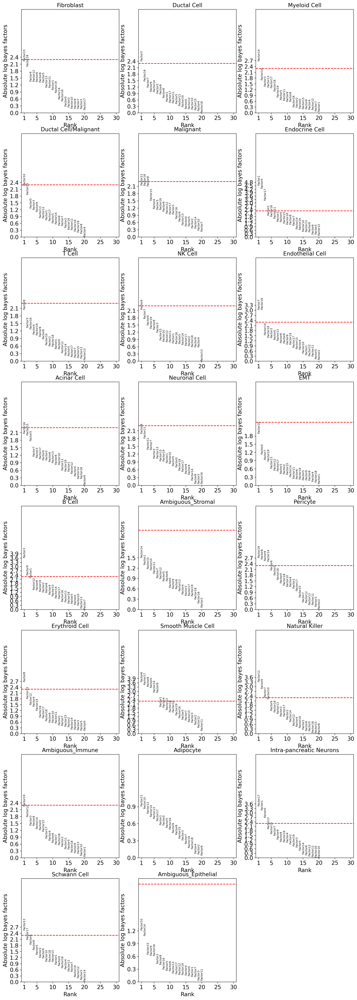

In [266]:
plt.rcParams['figure.figsize'] = (15,45)
fig = sca.plotting.plot_abs_bfs(adata_subset, fontsize=7, n_cols=3)
plt.show()

In [280]:
terms = intr_cvae.adata.uns["terms"]  
term_to_genes = {}
for term in terms:
    genes = intr_cvae.term_genes(term=term, terms="terms")
    term_to_genes[term] = genes

In [305]:
broad_markers = pd.read_csv('broad_markers.csv', index_col='Unnamed: 0')

In [328]:
broad_markers_list = list(set(broad_markers.values.flatten().astype(str)[broad_markers.values.flatten().astype(str) != 'nan']))

In [338]:
pd.DataFrame(broad_markers_list).to_csv('broad_markers_list.csv')

,0
0,LPL
1,IGFBP6
2,GPR87
3,CD4
4,AGR3
...,...
180,TAGLN
181,IRF7
182,LGALS4
183,ANXA4


In [343]:
sc.tl.rank_genes_groups(adata, groupby='Level_1', layer='log_norm')

In [453]:
df = pd.DataFrame(adata.uns['rank_genes_groups']['names']).head(30)

print(len(list(set(df.values.flatten()))))

genes_to_check = ([i for i in (list(set(df.values.flatten()))) if i not in genes_mofa_factors])
print(len(genes_to_check))

517
81


In [412]:
gene_to_group = {}
for gene in genes_to_check:
    test= df.where(df==gene).dropna(how='all').dropna(axis=1, how='all')
    cols = test.columns.tolist()
    gene_to_group[gene] = cols

In [464]:
gene_to_group_T = {}
for cols in df.columns:
    temp = df[cols]
    temp_genes = temp[temp.isin(genes_to_check)].tolist()
    gene_to_group_T[cols] = temp_genes

In [467]:
df = pd.DataFrame.from_dict(gene_to_group_T, orient='index')

In [472]:
from collections import Counter
Counter(pd.DataFrame.from_dict(gene_to_group, orient='index').values.flatten())

Counter({None: 69,
         'Ambiguous_Epithelial': 22,
         'Adipocyte': 13,
         'Neuronal Cell': 10,
         'Schwann Cell': 7,
         'Endocrine Cell': 6,
         'NK Cell': 6,
         'Ambiguous_Stromal': 6,
         'Erythroid Cell': 5,
         'Ambiguous_Immune': 5,
         'Intra-pancreatic Neurons': 3,
         'T Cell': 2,
         'B Cell': 2,
         'Pericyte': 2,
         'Acinar Cell': 2,
         'EMT': 1,
         'Smooth Muscle Cell': 1})

In [442]:
df = adata.obs.groupby(['outlier', 'Level_1']).size().unstack().T.sort_values(by='1', ascending=False)


In [445]:
df['% outliter'] = (df['1']/df.sum(axis=1))*100

In [447]:
df.sort_values(by='% outliter', ascending=False)


outlier,0,1,% outliter
Level_1,,,
Adipocyte,1659,1879,53.109101
Ambiguous_Epithelial,617,121,16.395664
Erythroid Cell,3792,564,12.947658
Ambiguous_Immune,3370,379,10.109362
Neuronal Cell,2819,292,9.386050
Ambiguous_Stromal,8183,726,8.149063
T Cell,174287,13509,7.193444
NK Cell,29069,1789,5.797524
B Cell,32305,1880,5.499488


In [516]:
de_genes = list(set([val for val in df.values.flatten() if val is not None]))
print(type(de_genes))

<class 'list'>


In [526]:
df_genes = pd.DataFrame({'Gene': de_genes})

In [528]:
print(type(df_genes))  # Should return <class 'pandas.core.frame.DataFrame'>
print(df_genes.head())  # View the first few rows
print(df_genes.columns)  # Check if columns are defined

<class 'pandas.core.frame.DataFrame'>
     Gene
0    NGFR
1     FGB
2   GAP43
3    HAMP
4  EEF1A2
Index(['Gene'], dtype='object')


In [532]:
df_genes.columns = ['Gene']

In [530]:
df_genes = pd.DataFrame(de_genes, columns=['Gene'])

In [544]:
df_genes.reset_index(inplace=True)

In [547]:
# df_genes.to_csv('de_genes_to_be_added.csv')
#TODO remove?

In [540]:
test = pd.read_pickle('de_genes_to_be_added.pkl')

In [546]:
# test.to_csv('test.csv')
#TODO remove?

In [ ]:
Genes from MOFA + genes from broad markers + genes from DE genes
#TODO remove, change to text cell?

In [565]:
all_genes = (genes_mofa_factors + broad_markers_list + de_genes)

In [572]:
len([i for i in list(set(all_genes)) if i not in adata.var_names])

19

In [554]:
test = pd.read_csv('../Expimap/expimap_10_factors_selected_norepeatinggenes/var_names.csv')

In [557]:
de_genes = pd.read_pickle('de_genes_to_be_added.csv')

In [564]:
de_genes = de_genes.values.flatten().tolist()

In [586]:
mofa_genes_df = pd.read_csv('../Expimap/expimap_10_factors_selected_norepeatinggenes/var_names.csv')
broad_markers = pd.read_csv('broad_markers.csv', index_col='Unnamed: 0')
broad_markers_list = list(set(broad_markers.values.flatten().astype(str)[broad_markers.values.flatten().astype(str) != 'nan']))
de_genes_df = pd.read_pickle('de_genes_to_be_added.csv')
mofa_genes = mofa_genes_df.values.flatten().tolist()
de_genes = de_genes_df.values.flatten().tolist()

In [590]:
xenium = pd.read_csv('pdac_xenium_panel.csv')

In [594]:
xenium_genes = list(set(xenium.Gene.tolist()))

In [605]:
valid_genes = [i for i in xenium_genes if i in adata.var_names]

In [609]:
genes_to_plot = [i for i in valid_genes if i not in all_genes]

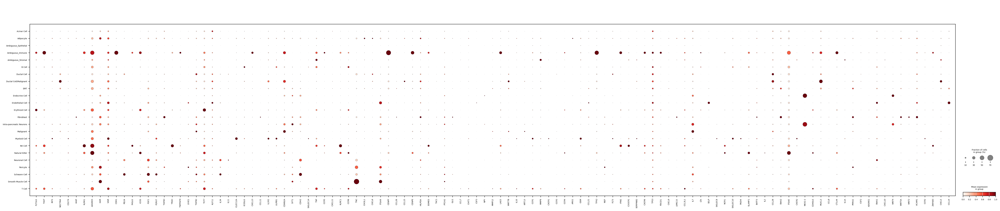

In [611]:
sc.pl.dotplot(adata, groupby='Level_1', var_names=genes_to_plot, layer='log_norm', standard_scale='var')

In [612]:
all_genes = list(set(mofa_genes + broad_markers_list + de_genes + xenium_genes))

In [614]:
all_genes = [i for i in all_genes if i in adata.var_names]

In [617]:
adata.X = adata.layers['log_norm']

In [648]:
sc.tl.pca(adata)

In [618]:
sc.tl.score_genes(adata, gene_list=all_genes)

In [638]:
adata_sub = adata[:, all_genes]

In [642]:
adata_sub.X = adata_sub.layers['log_norm']

In [643]:
sc.tl.pca(adata_sub)

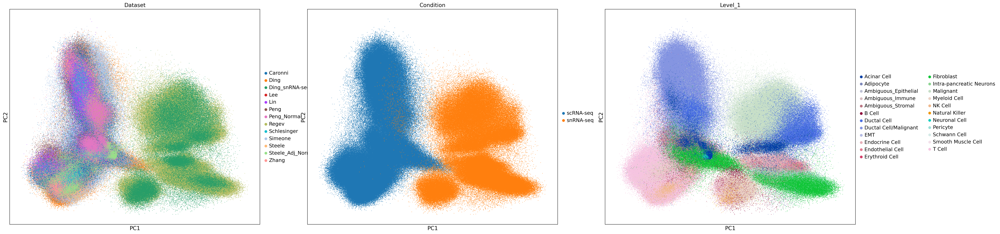

In [647]:
sc.pl.pca(adata_sub, color=['Dataset','Condition', 'Level_1'], size=5)

In [23]:
import pandas as pd
import numpy as np
#TODO necessary?

In [2]:
mofa_genes_df = pd.read_csv('../Expimap/expimap_10_factors_selected_norepeatinggenes/var_names.csv')
broad_markers = pd.read_csv('broad_markers.csv', index_col='Unnamed: 0')
broad_markers_list = list(set(broad_markers.values.flatten().astype(str)[broad_markers.values.flatten().astype(str) != 'nan']))
de_genes_df = pd.read_pickle('de_genes_to_be_added.csv')
mofa_genes = mofa_genes_df.values.flatten().tolist()
de_genes = de_genes_df.values.flatten().tolist()
xenium_df = pd.read_csv('pdac_xenium_panel.csv')
xenium_genes = list(set(xenium_df.Gene.tolist()))
print(f"Length of MOFA genes: {len(mofa_genes)}")
print(f"Length of broad marker genes: {len(broad_markers_list)}")
print(f"Length of DE genes: {len(de_genes)}")
print(f"Length of xenium panel genes: {len(xenium_genes)}")


Length of MOFA genes: 2134
Length of broad marker genes: 185
Length of DE genes: 81
Length of xenium panel genes: 480


In [47]:
all_genes = list(set(mofa_genes + broad_markers_list + de_genes + xenium_genes))

In [5]:
binary_matrix = pd.read_csv('../MOFA/MOFA_15_Factors_6082HVG/binary_matrix_15_factors.csv', index_col='Unnamed: 0')

In [18]:
genes = pd.read_csv('../MOFA/MOFA_15_Factors_6082HVG/genes.csv', index_col='Unnamed: 0')

In [19]:
def remove_overlapping_genes(column):
    global assigned_genes
    # Create a new column with the same length, fill it with NaN initially
    unique_genes = [np.nan] * len(column)
    # Iterate over the column, keep only genes that are not assigned
    for i, gene in enumerate(column):
        if gene not in assigned_genes:
            unique_genes[i] = gene
            assigned_genes.add(gene)
    return unique_genes


In [20]:
top_500_per_factor = genes[:500]

In [21]:
len(set(top_500_per_factor.values.flatten()))

2478

In [24]:
assigned_genes = set()
for col in top_500_per_factor.columns:
    top_500_per_factor[col] = remove_overlapping_genes(top_500_per_factor[col])

/tmp/ipykernel_4044581/2975508126.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  top_500_per_factor[col] = remove_overlapping_genes(top_500_per_factor[col])


In [27]:
top_500_per_factor = pd.DataFrame({col: top_500_per_factor[col].dropna().reset_index(drop=True) for col in top_500_per_factor.columns}).reindex(range(len(top_500_per_factor)))

In [32]:
len(set(top_500_per_factor.values.flatten()))

2479

In [33]:
all_genes = [x for x in list(set(top_500_per_factor.values.flatten().astype(str))) if x!= 'nan']
binary_matrix = pd.DataFrame(0, index=all_genes, columns=top_500_per_factor.columns)
for column in top_500_per_factor.columns:
    genes_in_program = top_500_per_factor[column].dropna()
    binary_matrix.loc[genes_in_program, column] = 1

In [34]:
cols = ['Factor' + str(i+1) for i in list(range(10))]
subset = top_500_per_factor[cols]